In [1]:
import numpy as np 
import pandas as pd
import json 
import csv
import nltk
import unicodedata
import re
import sys
from gensim.models.coherencemodel import CoherenceModel
from gensim import corpora, models
from gensim.utils import simple_preprocess
import gensim, spacy
from gensim.models.ldamulticore import LdaMulticore
import re
from gensim.models import Phrases
from gensim.models.phrases import Phraser

import os

In [2]:
# pip install git+https://github.com/rwalk/gsdmm.git

In [3]:
from gsdmm import MovieGroupProcess

In [4]:
df = pd.read_csv("pos_neg_usa.csv")
df

,Unnamed: 0,index,Text,new_text,languages,new_text_after_translation,pos_tagged_words,words_processed_all,words_processed_noun_adj_verb_adv,words_processed_noun,text_type,sentiment
0,0,0,want find way end racism try force people inje...,want find way end racism try force people inje...,ENGLISH,want find way end racism try force people inje...,"[('want', 'JJ'), ('find', 'VB'), ('way', 'NN')...","['want', 'find', 'way', 'end', 'racism', 'try'...","['want', 'find', 'way', 'end', 'racism', 'try'...","['way', 'end', 'racism', 'force', 'people', 'b...",subjective,2
1,1,1,"this child almost died tetanus, spent months h...","this child almost died tetanus, spent months h...",ENGLISH,"this child almost died tetanus, spent months h...","[('this', 'DT'), ('child', 'NN'), ('almost', '...","['child', 'almost', 'died', 'tetanus', 'spent'...","['child', 'almost', 'die', 'tetanus', 'spend',...","['child', 'tetanus', 'month', 'hospital', 'cos...",subjective,0
2,2,2,juste se rappeler m. leblanc la pression que l...,juste se rappeler m. leblanc la pression que l...,FRENCH,just remember mr. leblanc the pressure that th...,"[('just', 'RB'), ('remember', 'VB'), ('my', 'P...","['remember', 'leblanc', 'pressure', 'provincia...","['remember', 'leblanc', 'pressure', 'provincia...","['leblanc', 'pressure', 'business', 'world', '...",subjective,0
3,3,3,"you would expect cases rise significantly, cou...","you would expect cases rise significantly, cou...",ENGLISH,"you would expect cases rise significantly, cou...","[('you', 'PRP'), ('would', 'MD'), ('expect', '...","['would', 'expect', 'case', 'rise', 'significa...","['would', 'expect', 'case', 'rise', 'significa...","['case', 'vaccination', 'rate', 'play', 'space...",subjective,2
4,4,4,depends whether vaccination status is embedded...,depends whether vaccination status is embedded...,ENGLISH,depends whether vaccination status is embedded...,"[('depends', 'VBZ'), ('whether', 'IN'), ('vacc...","['depends', 'whether', 'vaccination', 'status'...","['depend', 'vaccination', 'status', 'embed', '...","['vaccination', 'status', 'code', 'link', 'con...",subjective,2
...,...,...,...,...,...,...,...,...,...,...,...,...
315598,404255,404255,pretty remarkable achievement. thank you all v...,pretty remarkable achievement. thank you all v...,ENGLISH,pretty remarkable achievement. thank you all v...,"[('pretty', 'RB'), ('remarkable', 'JJ'), ('ach...","['pretty', 'remarkable', 'achievement', 'thank...","['pretty', 'remarkable', 'achievement', 'thank...","['achievement', 'volunteer', 'shotsshotsshot',...",subjective,2
315599,404258,404258,oh that explains similar - seemingly out nowhe...,oh that explains similar - seemingly out nowhe...,ENGLISH,oh that explains similar - seemingly out nowhe...,"[('oh', 'UH'), ('that', 'DT'), ('explains', 'V...","['explains', 'similar', 'seemingly', 'nowhere'...","['explain', 'similar', 'seemingly', 'nowhere',...","['message', 'background', 'folk', 'vaccinesave...",subjective,0
315600,404260,404260,do it others.... 💪🎉💉🤙 #vaccinesaveslives,do it others.... flexed_bicepsparty_poppersyri...,ENGLISH,do it others.... flexed_bicepsparty_poppersyri...,"[('do', 'VB'), ('it', 'PRP'), ('others', 'NNS'...","['others', 'vaccinesaveslives']","['other', 'vaccinesaveslive']","['other', 'vaccinesaveslive']",subjective,2
315601,404262,404262,yay 🙌🏻 congrats dr. j being fully vaccinated i...,yay raising_handslight_skin_tone congrats dr. ...,ENGLISH,yay raising_handslight_skin_tone congrats dr. ...,"[('yay', 'NN'), ('congrats', 'NNS'), ('do', 'V...","['yay', 'congrats', 'fully', 'vaccinated', 'be...","['congrat', 'fully', 'vaccinate', 'good', 'fee...","['congrat', 'feeling', 'safetyfirst', 'vaccine...",subjective,2


In [5]:
df.drop(columns = ['Unnamed: 0', 'Text', 'index', 'new_text', 'languages',  'pos_tagged_words'], inplace = True)
df

,new_text_after_translation,words_processed_all,words_processed_noun_adj_verb_adv,words_processed_noun,text_type,sentiment
0,want find way end racism try force people inje...,"['want', 'find', 'way', 'end', 'racism', 'try'...","['want', 'find', 'way', 'end', 'racism', 'try'...","['way', 'end', 'racism', 'force', 'people', 'b...",subjective,2
1,"this child almost died tetanus, spent months h...","['child', 'almost', 'died', 'tetanus', 'spent'...","['child', 'almost', 'die', 'tetanus', 'spend',...","['child', 'tetanus', 'month', 'hospital', 'cos...",subjective,0
2,just remember mr. leblanc the pressure that th...,"['remember', 'leblanc', 'pressure', 'provincia...","['remember', 'leblanc', 'pressure', 'provincia...","['leblanc', 'pressure', 'business', 'world', '...",subjective,0
3,"you would expect cases rise significantly, cou...","['would', 'expect', 'case', 'rise', 'significa...","['would', 'expect', 'case', 'rise', 'significa...","['case', 'vaccination', 'rate', 'play', 'space...",subjective,2
4,depends whether vaccination status is embedded...,"['depends', 'whether', 'vaccination', 'status'...","['depend', 'vaccination', 'status', 'embed', '...","['vaccination', 'status', 'code', 'link', 'con...",subjective,2
...,...,...,...,...,...,...
315598,pretty remarkable achievement. thank you all v...,"['pretty', 'remarkable', 'achievement', 'thank...","['pretty', 'remarkable', 'achievement', 'thank...","['achievement', 'volunteer', 'shotsshotsshot',...",subjective,2
315599,oh that explains similar - seemingly out nowhe...,"['explains', 'similar', 'seemingly', 'nowhere'...","['explain', 'similar', 'seemingly', 'nowhere',...","['message', 'background', 'folk', 'vaccinesave...",subjective,0
315600,do it others.... flexed_bicepsparty_poppersyri...,"['others', 'vaccinesaveslives']","['other', 'vaccinesaveslive']","['other', 'vaccinesaveslive']",subjective,2
315601,yay raising_handslight_skin_tone congrats dr. ...,"['yay', 'congrats', 'fully', 'vaccinated', 'be...","['congrat', 'fully', 'vaccinate', 'good', 'fee...","['congrat', 'feeling', 'safetyfirst', 'vaccine...",subjective,2


In [6]:
df['words_processed_noun'].values[0][0]

'['

In [7]:
def sent_to_words(sentences):
    for sentence in sentences:
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))

In [8]:
tokens_words_processed_noun = list(sent_to_words(df['words_processed_noun']))

In [9]:
from nltk.corpus import stopwords
stop_list = stopwords.words('english')
high_freq_known_words = ['covid','couid', 'pfizer', 'amp', 'people', 'covidvaccine', 'covishield', 'moderna', 'vaccine', 'vaccinated', 'vaccination', 'vaccines']

stop_list.extend(high_freq_known_words)

test_words_only1 = ['not', 'vaccine', 'covid', 'and', 'vegan', 'cruelty', 'free', 'i', 'use', 'elf', 'cosmetics', 'every', 'day', 'and', 'i', 'love', 'it']
test_stopremoved = [w for w in test_words_only1 if w not in stop_list or w == 'not']
print(test_stopremoved)

['not', 'vegan', 'cruelty', 'free', 'use', 'elf', 'cosmetics', 'every', 'day', 'love']


In [10]:
stop_list

['i',
 'me',
 'my',
 'myself',
 'we',
 'our',
 'ours',
 'ourselves',
 'you',
 "you're",
 "you've",
 "you'll",
 "you'd",
 'your',
 'yours',
 'yourself',
 'yourselves',
 'he',
 'him',
 'his',
 'himself',
 'she',
 "she's",
 'her',
 'hers',
 'herself',
 'it',
 "it's",
 'its',
 'itself',
 'they',
 'them',
 'their',
 'theirs',
 'themselves',
 'what',
 'which',
 'who',
 'whom',
 'this',
 'that',
 "that'll",
 'these',
 'those',
 'am',
 'is',
 'are',
 'was',
 'were',
 'be',
 'been',
 'being',
 'have',
 'has',
 'had',
 'having',
 'do',
 'does',
 'did',
 'doing',
 'a',
 'an',
 'the',
 'and',
 'but',
 'if',
 'or',
 'because',
 'as',
 'until',
 'while',
 'of',
 'at',
 'by',
 'for',
 'with',
 'about',
 'against',
 'between',
 'into',
 'through',
 'during',
 'before',
 'after',
 'above',
 'below',
 'to',
 'from',
 'up',
 'down',
 'in',
 'out',
 'on',
 'off',
 'over',
 'under',
 'again',
 'further',
 'then',
 'once',
 'here',
 'there',
 'when',
 'where',
 'why',
 'how',
 'all',
 'any',
 'both',
 'each

In [11]:
df['words_processed_noun'] = tokens_words_processed_noun

In [12]:
# remove stop words from tokenised_words_only

tokenised_stopremoved = [[w for w in each if w not in stop_list or w == 'not'] for each in tokens_words_processed_noun]
tokenised_stopremoved

[['way', 'end', 'racism', 'force', 'bunch', 'race', 'support', 'force'],
 ['child', 'tetanus', 'month', 'hospital', 'cost', 'parent', 'pandemic'],
 ['leblanc',
  'pressure',
  'business',
  'world',
  'border',
  'air',
  'traffic',
  'block',
  'tourist',
  'hotel',
  'restaurant'],
 ['case',
  'rate',
  'play',
  'space',
  'adult',
  'space',
  'school',
  'age',
  'student',
  'datum',
  'state',
  'bear'],
 ['status', 'code', 'link', 'connect', 'end', 'read'],
 ['isolation', 'question', 'look', 'spike', 'matter', 'thing'],
 ['center', 'parent', 'mask', 'answer'],
 ['tool',
  'suite',
  'leader',
  'combat',
  'hesitancy',
  'resistance',
  'video',
  'article'],
 ['goal', 'blogger', 'news', 'accident', 'step', 'competence'],
 ['head', 'brain', 'place', 'rate', 'case_count', 'dictatorship', 'name'],
 ['world', 'passport', 'goal'],
 ['restaurant', 'arena', 'fitness', 'center', 'rate'],
 ['age',
  'hour',
  'infection',
  'booster',
  'infection',
  'protect',
  'hypnotoad',
  'phero

In [13]:
df['words_processed_noun'].values[0][0]

'way'

In [14]:
df['tokenised_stopremoved'] = tokenised_stopremoved

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 315603 entries, 0 to 315602
Data columns (total 7 columns):
 #   Column                             Non-Null Count   Dtype 
---  ------                             --------------   ----- 
 0   new_text_after_translation         315603 non-null  object
 1   words_processed_all                315603 non-null  object
 2   words_processed_noun_adj_verb_adv  315603 non-null  object
 3   words_processed_noun               315603 non-null  object
 4   text_type                          315603 non-null  object
 5   sentiment                          315603 non-null  int64 
 6   tokenised_stopremoved              315603 non-null  object
dtypes: int64(1), object(6)
memory usage: 16.9+ MB


# GSDMM for the topic modeling: 

In [16]:
np.random.seed(0)

In [17]:
df.info() # no empty rows

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 315603 entries, 0 to 315602
Data columns (total 7 columns):
 #   Column                             Non-Null Count   Dtype 
---  ------                             --------------   ----- 
 0   new_text_after_translation         315603 non-null  object
 1   words_processed_all                315603 non-null  object
 2   words_processed_noun_adj_verb_adv  315603 non-null  object
 3   words_processed_noun               315603 non-null  object
 4   text_type                          315603 non-null  object
 5   sentiment                          315603 non-null  int64 
 6   tokenised_stopremoved              315603 non-null  object
dtypes: int64(1), object(6)
memory usage: 16.9+ MB


In [18]:
df['sentiment'].value_counts()

2    222780
0     92823
Name: sentiment, dtype: int64

In [19]:
negative_df = df[df['sentiment'] == 0]

In [20]:
negative_df

,new_text_after_translation,words_processed_all,words_processed_noun_adj_verb_adv,words_processed_noun,text_type,sentiment,tokenised_stopremoved
1,"this child almost died tetanus, spent months h...","['child', 'almost', 'died', 'tetanus', 'spent'...","['child', 'almost', 'die', 'tetanus', 'spend',...","[child, tetanus, month, hospital, cost, parent...",subjective,0,"[child, tetanus, month, hospital, cost, parent..."
2,just remember mr. leblanc the pressure that th...,"['remember', 'leblanc', 'pressure', 'provincia...","['remember', 'leblanc', 'pressure', 'provincia...","[leblanc, pressure, business, world, border, a...",subjective,0,"[leblanc, pressure, business, world, border, a..."
9,does it hurt your head actually use your brain...,"['hurt', 'head', 'actually', 'use', 'brain', '...","['head', 'actually', 'use', 'brain', 'seem', '...","[head, brain, place, vaccination, rate, case_c...",subjective,0,"[head, brain, place, rate, case_count, dictato..."
10,world-wide mass vaccination leading world-wide...,"['world', 'wide', 'mass', 'vaccination', 'lead...","['wide', 'mass', 'vaccination', 'lead', 'world...","[vaccination, world, passport, goal]",subjective,0,"[world, passport, goal]"
19,oh i see. so what your saying is that alberta ...,"['see', 'saying', 'alberta', 'business', 'requ...","['say', 'business', 'require', 'proof', 'vacci...","[business, proof, vaccination, government, pro...",subjective,0,"[business, proof, government, province]"
...,...,...,...,...,...,...,...
315583,half my friends sick af. all vaccinated. sheesh,"['half', 'friend', 'sick', 'vaccinated', 'shee...","['half', 'friend', 'sick', 'vaccinate', 'sheesh']",[friend],subjective,0,[friend]
315584,merry christmas Christmas_tree i hope things i...,"['merry_christmas', 'hope', 'thing', 'improve'...","['hope', 'thing', 'improve', 'son', 'triple', ...","[thing, son, friend, amp, daughter, son, state]",subjective,0,"[thing, son, friend, daughter, son, state]"
315587,no me refería este positivo grinning_face_with...,"['refer', 'este', 'positive', 'positive', 'cov...","['refer', 'positive', 'positive', 'covidtestin...",[covidtesting],subjective,0,[covidtesting]
315592,acute #stroke #covid pneumonia #novax #coronav...,"['acute', 'stroke', 'couid', 'pneumonia', 'nov...","['acute', 'vaccinate', 'vaccinesaveslive', 'va...","[vaccine, deltavariant]",subjective,0,[deltavariant]


In [21]:
negative_df['tokenised_stopremoved'].values[0][0]

'child'

In [22]:
negative_tokenised_lemmatized = list(sent_to_words(negative_df['tokenised_stopremoved']))

In [23]:
negative_tokenised_lemmatized[0][0]

'child'

In [24]:
len(negative_tokenised_lemmatized)

92823

In [25]:
def top_words(cluster_word_distribution, top_cluster, values):
    for cluster in top_cluster:
        sort_dicts =sorted(mgp.cluster_word_distribution[cluster].items(), key=lambda k: k[1], reverse=True)[:values]
        print("\nCluster %s : %s"%(cluster,sort_dicts))

### Cluster size: 4

In [26]:
mgp = MovieGroupProcess(K=4, alpha=0.1, beta=0.2, n_iters=30)

vocab = set(x for review in negative_tokenised_lemmatized for x in review)
n_terms = len(vocab)
model = mgp.fit(negative_tokenised_lemmatized, n_terms)

In stage 0: transferred 66791 clusters with 4 clusters populated
In stage 1: transferred 58045 clusters with 4 clusters populated
In stage 2: transferred 52910 clusters with 4 clusters populated
In stage 3: transferred 48052 clusters with 4 clusters populated
In stage 4: transferred 42570 clusters with 4 clusters populated
In stage 5: transferred 38802 clusters with 4 clusters populated
In stage 6: transferred 36709 clusters with 4 clusters populated
In stage 7: transferred 35329 clusters with 4 clusters populated
In stage 8: transferred 34005 clusters with 4 clusters populated
In stage 9: transferred 33034 clusters with 4 clusters populated
In stage 10: transferred 32111 clusters with 4 clusters populated
In stage 11: transferred 31536 clusters with 4 clusters populated
In stage 12: transferred 31256 clusters with 4 clusters populated
In stage 13: transferred 31393 clusters with 4 clusters populated
In stage 14: transferred 31292 clusters with 4 clusters populated
In stage 15: transfe

In [27]:
doc_count = np.array(mgp.cluster_doc_count)
print('Number of documents per topic :', doc_count)

# topics sorted by the number of document they are allocated to
top_index = doc_count.argsort()[-10:][::-1]
print('\nMost important clusters (by number of docs inside):', top_index)
# show the top 5 words in term frequency for each cluster 
top_words(mgp.cluster_word_distribution, top_index, 10)

Number of documents per topic : [27151 21938 17254 26480]

Most important clusters (by number of docs inside): [0 3 1 2]

Cluster 0 : [('mask', 1836), ('mandate', 1566), ('government', 1442), ('country', 1112), ('trucker', 1023), ('time', 882), ('work', 833), ('thing', 743), ('protest', 724), ('anthrax', 720)]

Cluster 3 : [('death', 4938), ('rate', 3478), ('risk', 2431), ('virus', 2357), ('hospital', 2271), ('case', 1946), ('number', 1748), ('population', 1505), ('child', 1335), ('mask', 1279)]

Cluster 1 : [('government', 1219), ('money', 1067), ('science', 956), ('anthrax', 852), ('year', 792), ('fact', 789), ('trust', 764), ('time', 677), ('company', 672), ('thing', 659)]

Cluster 2 : [('shot', 2119), ('day', 1466), ('booster', 1271), ('hospital', 1184), ('friend', 724), ('child', 711), ('time', 672), ('arm', 647), ('shit', 644), ('wife', 590)]


In [28]:
# I don`t rename the clusters

topic_dict = {}
topic_names = ['type 1',
               'type 2',
               'type 3',
               'type 4'
              ]
for i, topic_num in enumerate(top_index):
    topic_dict[topic_num]=topic_names[i] 

In [29]:
def create_topics_dataframe(data_text=negative_df.new_text_after_translation,  mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized):
    result = pd.DataFrame(columns=['Text', 'Topic', 'Lemma-text'])
    for i, text in enumerate(data_text):
        result.at[i, 'Text'] = text
        result.at[i, 'Lemma-text'] = lemma_text[i]
        prob = mgp.choose_best_label(negative_tokenised_lemmatized[i])
        if prob[1] >= threshold:
            result.at[i, 'Topic'] = topic_dict[prob[0]]
        else:
            result.at[i, 'Topic'] = 'Other'
    return result

In [30]:
result = create_topics_dataframe(data_text=negative_df.new_text_after_translation, mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized)
result.head(5)

,Text,Topic,Lemma-text
0,"this child almost died tetanus, spent months h...",type 2,"[child, tetanus, month, hospital, cost, parent..."
1,just remember mr. leblanc the pressure that th...,type 1,"[leblanc, pressure, business, world, border, a..."
2,does it hurt your head actually use your brain...,type 1,"[head, brain, place, rate, case_count, dictato..."
3,world-wide mass vaccination leading world-wide...,type 1,"[world, passport, goal]"
4,oh i see. so what your saying is that alberta ...,type 1,"[business, proof, government, province]"


In [31]:
import plotly.express as px

fig = px.pie(result, names='Topic',  title='Topics', color_discrete_sequence=px.colors.sequential.Burg)
fig.show()

In [32]:
result['Topic']

0        type 2
1        type 1
2        type 1
3        type 1
4        type 1
          ...  
92818    type 4
92819    type 4
92820    type 4
92821    type 2
92822    type 1
Name: Topic, Length: 92823, dtype: object

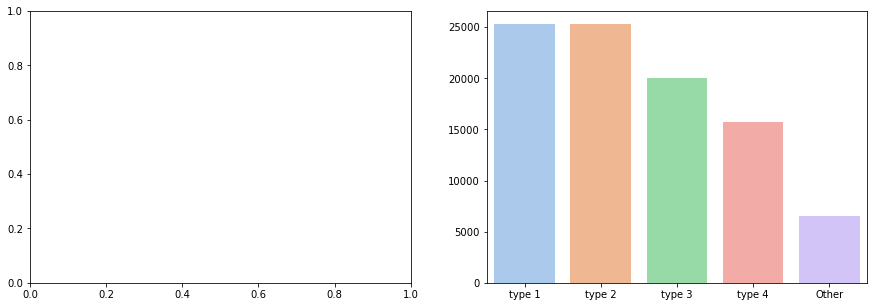

In [33]:
import matplotlib.pyplot as plt
import seaborn as sns
types_counts = result.Topic.value_counts()
fig, ax = plt.subplots(1, 2, figsize=(15,5))
types = sns.barplot(x = types_counts.index, y = types_counts.values, palette="pastel", ax=ax[1])


In [34]:
result['len'] = result.Text.apply(lambda row: len(row.split()))
result.head()

,Text,Topic,Lemma-text,len
0,"this child almost died tetanus, spent months h...",type 2,"[child, tetanus, month, hospital, cost, parent...",21
1,just remember mr. leblanc the pressure that th...,type 1,"[leblanc, pressure, business, world, border, a...",48
2,does it hurt your head actually use your brain...,type 1,"[head, brain, place, rate, case_count, dictato...",37
3,world-wide mass vaccination leading world-wide...,type 1,"[world, passport, goal]",11
4,oh i see. so what your saying is that alberta ...,type 1,"[business, proof, government, province]",26


In [35]:
result['Lemma_text'] = result['Lemma-text'].apply(lambda row: ' '.join(row))

In [36]:
result = result.drop('Lemma-text', axis=1)

In [37]:
from wordcloud import WordCloud 

In [38]:
def create_WordCloud(data, title=None):
    wordcloud = WordCloud(width = 500, height = 500,
                          background_color ='white',
                          min_font_size = 15, collocations=False
                         ).generate(" ".join(data.values))
                      
    plt.figure(figsize = (5, 5), facecolor = None) 
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(title,fontsize=20)
    plt.show() 

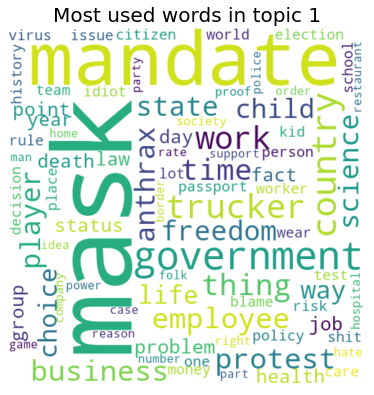

In [39]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 1'], title="Most used words in topic 1")

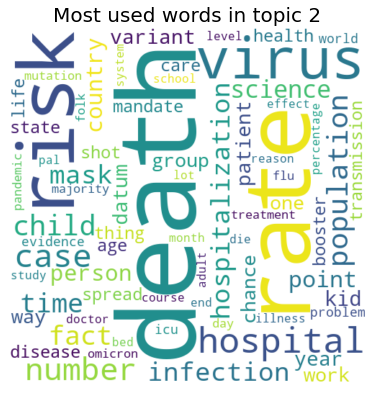

In [40]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 2'], title="Most used words in topic 2")

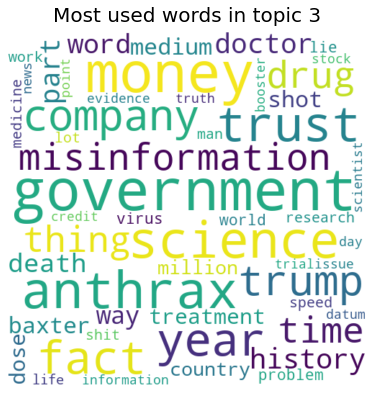

In [41]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 3'], title="Most used words in topic 3")

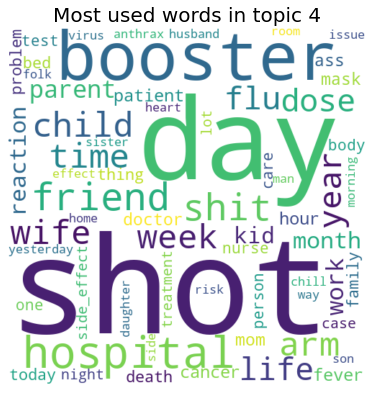

In [42]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 4'], title="Most used words in topic 4")

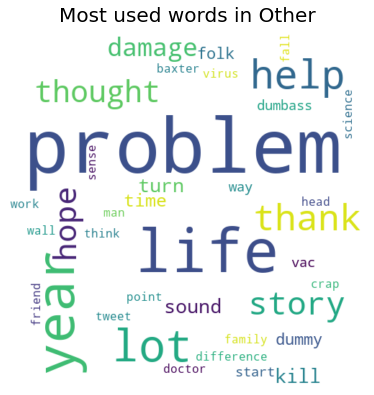

In [43]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'Other'], title="Most used words in Other")

### Cluster size: 5

In [44]:
mgp = MovieGroupProcess(K=5, alpha=0.1, beta=0.2, n_iters=30)

vocab = set(x for review in negative_tokenised_lemmatized for x in review)
n_terms = len(vocab)
model = mgp.fit(negative_tokenised_lemmatized, n_terms)

In stage 0: transferred 71426 clusters with 5 clusters populated
In stage 1: transferred 62387 clusters with 5 clusters populated
In stage 2: transferred 55753 clusters with 5 clusters populated
In stage 3: transferred 48477 clusters with 5 clusters populated
In stage 4: transferred 42215 clusters with 5 clusters populated
In stage 5: transferred 38675 clusters with 5 clusters populated
In stage 6: transferred 37015 clusters with 5 clusters populated
In stage 7: transferred 36008 clusters with 5 clusters populated
In stage 8: transferred 35258 clusters with 5 clusters populated
In stage 9: transferred 34985 clusters with 5 clusters populated
In stage 10: transferred 34616 clusters with 5 clusters populated
In stage 11: transferred 34495 clusters with 5 clusters populated
In stage 12: transferred 34314 clusters with 5 clusters populated
In stage 13: transferred 34163 clusters with 5 clusters populated
In stage 14: transferred 33842 clusters with 5 clusters populated
In stage 15: transfe

In [45]:
doc_count = np.array(mgp.cluster_doc_count)
print('Number of documents per topic :', doc_count)

# topics sorted by the number of document they are allocated to
top_index = doc_count.argsort()[-10:][::-1]
print('\nMost important clusters (by number of docs inside):', top_index)
# show the top 5 words in term frequency for each cluster 
top_words(mgp.cluster_word_distribution, top_index, 10)

Number of documents per topic : [ 9208 24175 19962 21168 18310]

Most important clusters (by number of docs inside): [1 3 2 4 0]

Cluster 1 : [('science', 1301), ('anthrax', 1286), ('government', 1063), ('fact', 886), ('thing', 856), ('trust', 838), ('money', 832), ('time', 809), ('misinformation', 792), ('death', 782)]

Cluster 3 : [('death', 4486), ('rate', 3289), ('virus', 1953), ('risk', 1866), ('case', 1772), ('number', 1577), ('population', 1419), ('infection', 1151), ('hospitalization', 1140), ('fact', 1029)]

Cluster 2 : [('hospital', 2673), ('mask', 1974), ('child', 1855), ('kid', 1092), ('risk', 990), ('patient', 981), ('death', 971), ('parent', 880), ('care', 862), ('life', 842)]

Cluster 4 : [('government', 1436), ('mandate', 1208), ('country', 1005), ('trucker', 940), ('business', 703), ('employee', 687), ('mask', 645), ('money', 622), ('player', 622), ('work', 618)]

Cluster 0 : [('shot', 1716), ('booster', 1094), ('day', 1076), ('arm', 628), ('dose', 464), ('fever', 436)

In [46]:
# I don`t rename the clusters

topic_dict = {}
topic_names = ['type 1',
               'type 2',
               'type 3',
               'type 4',
               'type 5'
              ]
for i, topic_num in enumerate(top_index):
    topic_dict[topic_num]=topic_names[i] 

In [47]:
def create_topics_dataframe(data_text=negative_df.new_text_after_translation,  mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized):
    result = pd.DataFrame(columns=['Text', 'Topic', 'Lemma-text'])
    for i, text in enumerate(data_text):
        result.at[i, 'Text'] = text
        result.at[i, 'Lemma-text'] = lemma_text[i]
        prob = mgp.choose_best_label(negative_tokenised_lemmatized[i])
        if prob[1] >= threshold:
            result.at[i, 'Topic'] = topic_dict[prob[0]]
        else:
            result.at[i, 'Topic'] = 'Other'
    return result

In [48]:
result = create_topics_dataframe(data_text=negative_df.new_text_after_translation, mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized)
result.head(5)

,Text,Topic,Lemma-text
0,"this child almost died tetanus, spent months h...",type 3,"[child, tetanus, month, hospital, cost, parent..."
1,just remember mr. leblanc the pressure that th...,type 4,"[leblanc, pressure, business, world, border, a..."
2,does it hurt your head actually use your brain...,type 2,"[head, brain, place, rate, case_count, dictato..."
3,world-wide mass vaccination leading world-wide...,type 4,"[world, passport, goal]"
4,oh i see. so what your saying is that alberta ...,type 4,"[business, proof, government, province]"


In [49]:
import plotly.express as px

fig = px.pie(result, names='Topic',  title='Topics', color_discrete_sequence=px.colors.sequential.Burg)
fig.show()

In [50]:
result['Topic']

0        type 3
1        type 4
2        type 2
3        type 4
4        type 4
          ...  
92818    type 3
92819    type 3
92820    type 5
92821    type 2
92822    type 1
Name: Topic, Length: 92823, dtype: object

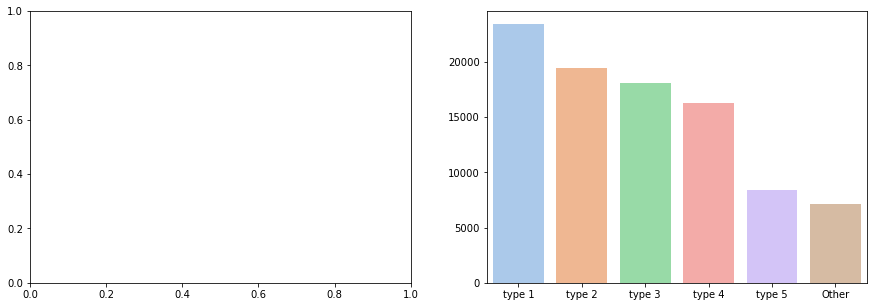

In [51]:
import matplotlib.pyplot as plt
import seaborn as sns
types_counts = result.Topic.value_counts()
fig, ax = plt.subplots(1, 2, figsize=(15,5))
types = sns.barplot(x = types_counts.index, y = types_counts.values, palette="pastel", ax=ax[1])


In [52]:
result['len'] = result.Text.apply(lambda row: len(row.split()))
result.head()

,Text,Topic,Lemma-text,len
0,"this child almost died tetanus, spent months h...",type 3,"[child, tetanus, month, hospital, cost, parent...",21
1,just remember mr. leblanc the pressure that th...,type 4,"[leblanc, pressure, business, world, border, a...",48
2,does it hurt your head actually use your brain...,type 2,"[head, brain, place, rate, case_count, dictato...",37
3,world-wide mass vaccination leading world-wide...,type 4,"[world, passport, goal]",11
4,oh i see. so what your saying is that alberta ...,type 4,"[business, proof, government, province]",26


In [53]:
result['Lemma_text'] = result['Lemma-text'].apply(lambda row: ' '.join(row))

In [54]:
result = result.drop('Lemma-text', axis=1)

In [55]:
from wordcloud import WordCloud 

In [56]:
def create_WordCloud(data, title=None):
    wordcloud = WordCloud(width = 500, height = 500,
                          background_color ='white',
                          min_font_size = 15, collocations=False
                         ).generate(" ".join(data.values))
                      
    plt.figure(figsize = (5, 5), facecolor = None) 
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(title,fontsize=20)
    plt.show() 

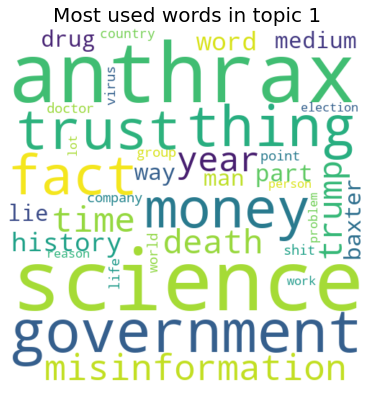

In [57]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 1'], title="Most used words in topic 1")

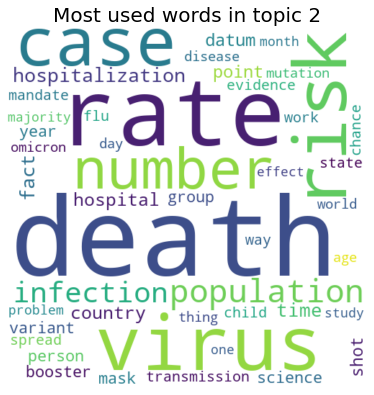

In [58]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 2'], title="Most used words in topic 2")

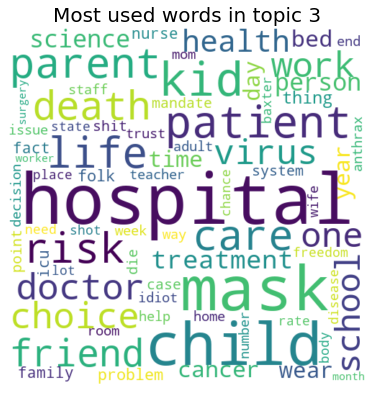

In [59]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 3'], title="Most used words in topic 3")

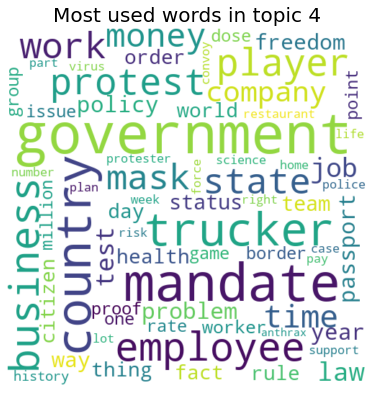

In [60]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 4'], title="Most used words in topic 4")

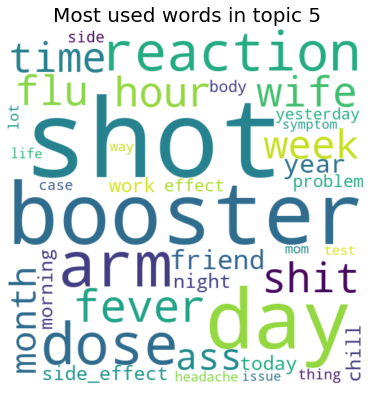

In [61]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 5'], title="Most used words in topic 5")

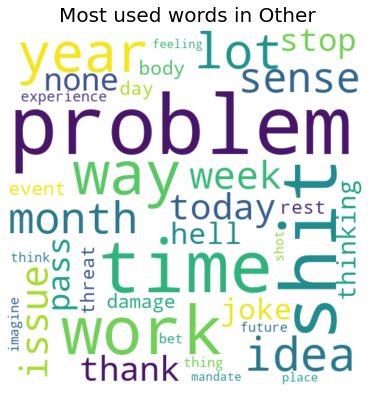

In [62]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'Other'], title="Most used words in Other")

### Cluster size: 6

In [63]:
mgp = MovieGroupProcess(K=6, alpha=0.1, beta=0.2, n_iters=30)

vocab = set(x for review in negative_tokenised_lemmatized for x in review)
n_terms = len(vocab)
model = mgp.fit(negative_tokenised_lemmatized, n_terms)

In stage 0: transferred 74498 clusters with 6 clusters populated
In stage 1: transferred 65130 clusters with 6 clusters populated
In stage 2: transferred 59273 clusters with 6 clusters populated
In stage 3: transferred 52884 clusters with 6 clusters populated
In stage 4: transferred 47259 clusters with 6 clusters populated
In stage 5: transferred 43212 clusters with 6 clusters populated
In stage 6: transferred 40818 clusters with 6 clusters populated
In stage 7: transferred 39357 clusters with 6 clusters populated
In stage 8: transferred 38111 clusters with 6 clusters populated
In stage 9: transferred 37397 clusters with 6 clusters populated
In stage 10: transferred 36775 clusters with 6 clusters populated
In stage 11: transferred 36516 clusters with 6 clusters populated
In stage 12: transferred 36009 clusters with 6 clusters populated
In stage 13: transferred 35667 clusters with 6 clusters populated
In stage 14: transferred 35619 clusters with 6 clusters populated
In stage 15: transfe

In [64]:
doc_count = np.array(mgp.cluster_doc_count)
print('Number of documents per topic :', doc_count)

# topics sorted by the number of document they are allocated to
top_index = doc_count.argsort()[-10:][::-1]
print('\nMost important clusters (by number of docs inside):', top_index)
# show the top 5 words in term frequency for each cluster 
top_words(mgp.cluster_word_distribution, top_index, 10)

Number of documents per topic : [15846 24718  8847  9577 19207 14628]

Most important clusters (by number of docs inside): [1 4 0 5 3 2]

Cluster 1 : [('government', 1477), ('science', 1166), ('money', 1149), ('anthrax', 1060), ('fact', 884), ('year', 872), ('trust', 826), ('time', 778), ('trump', 770), ('thing', 757)]

Cluster 4 : [('death', 4314), ('rate', 3105), ('virus', 1902), ('risk', 1698), ('case', 1694), ('number', 1546), ('population', 1377), ('hospitalization', 1121), ('infection', 1113), ('time', 978)]

Cluster 0 : [('mask', 2249), ('child', 1975), ('kid', 1250), ('parent', 912), ('risk', 834), ('death', 774), ('life', 746), ('virus', 697), ('school', 689), ('science', 611)]

Cluster 5 : [('mandate', 1070), ('government', 1009), ('trucker', 946), ('country', 656), ('employee', 638), ('protest', 630), ('player', 625), ('business', 592), ('time', 502), ('work', 470)]

Cluster 3 : [('hospital', 2373), ('patient', 1010), ('care', 635), ('doctor', 572), ('treatment', 560), ('bed

In [65]:
# I don`t rename the clusters

topic_dict = {}
topic_names = ['type 1',
               'type 2',
               'type 3',
               'type 4',
               'type 5',
               'type 6'
              ]
for i, topic_num in enumerate(top_index):
    topic_dict[topic_num]=topic_names[i] 

In [66]:
def create_topics_dataframe(data_text=negative_df.new_text_after_translation,  mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized):
    result = pd.DataFrame(columns=['Text', 'Topic', 'Lemma-text'])
    for i, text in enumerate(data_text):
        result.at[i, 'Text'] = text
        result.at[i, 'Lemma-text'] = lemma_text[i]
        prob = mgp.choose_best_label(negative_tokenised_lemmatized[i])
        if prob[1] >= threshold:
            result.at[i, 'Topic'] = topic_dict[prob[0]]
        else:
            result.at[i, 'Topic'] = 'Other'
    return result

In [67]:
result = create_topics_dataframe(data_text=negative_df.new_text_after_translation, mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized)
result.head(5)

,Text,Topic,Lemma-text
0,"this child almost died tetanus, spent months h...",type 3,"[child, tetanus, month, hospital, cost, parent..."
1,just remember mr. leblanc the pressure that th...,type 4,"[leblanc, pressure, business, world, border, a..."
2,does it hurt your head actually use your brain...,type 4,"[head, brain, place, rate, case_count, dictato..."
3,world-wide mass vaccination leading world-wide...,type 4,"[world, passport, goal]"
4,oh i see. so what your saying is that alberta ...,type 4,"[business, proof, government, province]"


In [68]:
import plotly.express as px

fig = px.pie(result, names='Topic',  title='Topics', color_discrete_sequence=px.colors.sequential.Burg)
fig.show()

In [69]:
result['Topic']

0        type 3
1        type 4
2        type 4
3        type 4
4        type 4
          ...  
92818    type 3
92819    type 3
92820    type 4
92821    type 3
92822    type 3
Name: Topic, Length: 92823, dtype: object

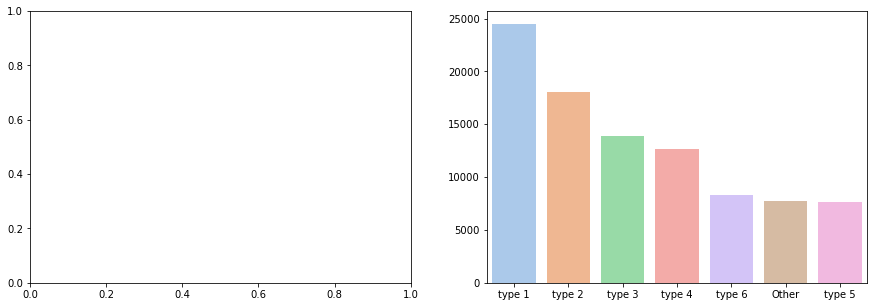

In [70]:
import matplotlib.pyplot as plt
import seaborn as sns
types_counts = result.Topic.value_counts()
fig, ax = plt.subplots(1, 2, figsize=(15,5))
types = sns.barplot(x = types_counts.index, y = types_counts.values, palette="pastel", ax=ax[1])


In [71]:
result['len'] = result.Text.apply(lambda row: len(row.split()))
result.head()

,Text,Topic,Lemma-text,len
0,"this child almost died tetanus, spent months h...",type 3,"[child, tetanus, month, hospital, cost, parent...",21
1,just remember mr. leblanc the pressure that th...,type 4,"[leblanc, pressure, business, world, border, a...",48
2,does it hurt your head actually use your brain...,type 4,"[head, brain, place, rate, case_count, dictato...",37
3,world-wide mass vaccination leading world-wide...,type 4,"[world, passport, goal]",11
4,oh i see. so what your saying is that alberta ...,type 4,"[business, proof, government, province]",26


In [72]:
result['Lemma_text'] = result['Lemma-text'].apply(lambda row: ' '.join(row))

In [73]:
result = result.drop('Lemma-text', axis=1)

In [74]:
from wordcloud import WordCloud 

In [75]:
def create_WordCloud(data, title=None):
    wordcloud = WordCloud(width = 500, height = 500,
                          background_color ='white',
                          min_font_size = 15, collocations=False
                         ).generate(" ".join(data.values))
                      
    plt.figure(figsize = (5, 5), facecolor = None) 
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(title,fontsize=20)
    plt.show() 

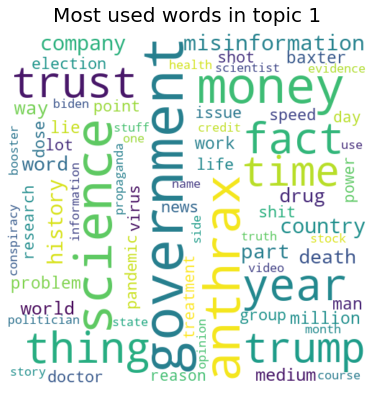

In [76]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 1'], title="Most used words in topic 1")

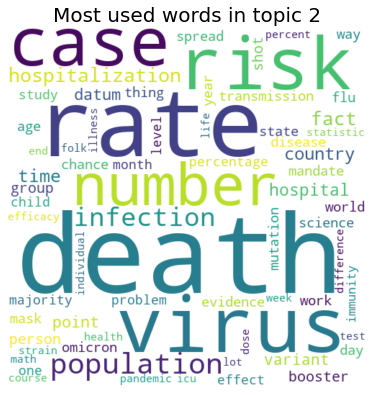

In [77]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 2'], title="Most used words in topic 2")

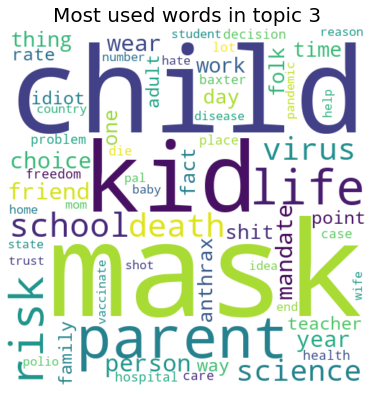

In [78]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 3'], title="Most used words in topic 3")

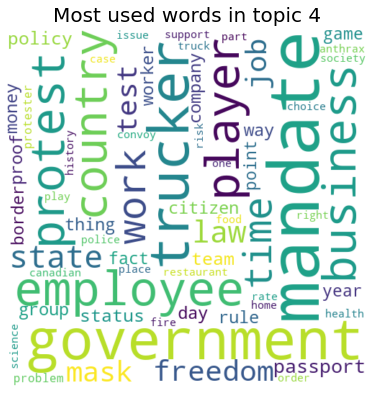

In [79]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 4'], title="Most used words in topic 4")

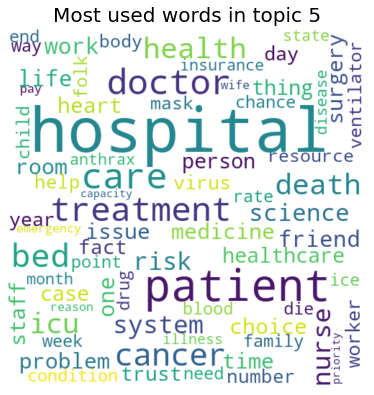

In [80]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 5'], title="Most used words in topic 5")

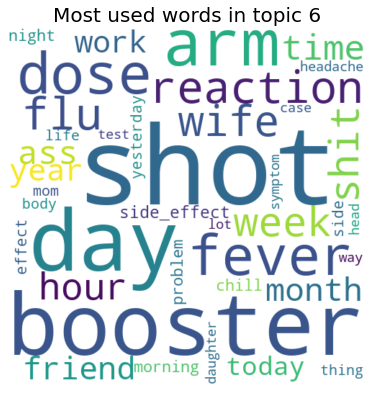

In [81]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 6'], title="Most used words in topic 6")

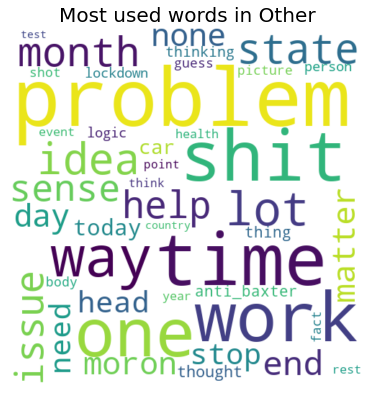

In [82]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'Other'], title="Most used words in Other")

### Cluster size: 7

In [83]:
mgp = MovieGroupProcess(K=7, alpha=0.1, beta=0.2, n_iters=30)

vocab = set(x for review in negative_tokenised_lemmatized for x in review)
n_terms = len(vocab)
model = mgp.fit(negative_tokenised_lemmatized, n_terms)

In stage 0: transferred 76619 clusters with 7 clusters populated
In stage 1: transferred 67299 clusters with 7 clusters populated
In stage 2: transferred 60092 clusters with 7 clusters populated
In stage 3: transferred 51925 clusters with 7 clusters populated
In stage 4: transferred 45656 clusters with 7 clusters populated
In stage 5: transferred 41706 clusters with 7 clusters populated
In stage 6: transferred 39486 clusters with 7 clusters populated
In stage 7: transferred 38345 clusters with 7 clusters populated
In stage 8: transferred 37412 clusters with 7 clusters populated
In stage 9: transferred 36853 clusters with 7 clusters populated
In stage 10: transferred 36451 clusters with 7 clusters populated
In stage 11: transferred 36329 clusters with 7 clusters populated
In stage 12: transferred 36410 clusters with 7 clusters populated
In stage 13: transferred 35922 clusters with 7 clusters populated
In stage 14: transferred 35911 clusters with 7 clusters populated
In stage 15: transfe

In [84]:
doc_count = np.array(mgp.cluster_doc_count)
print('Number of documents per topic :', doc_count)

# topics sorted by the number of document they are allocated to
top_index = doc_count.argsort()[-10:][::-1]
print('\nMost important clusters (by number of docs inside):', top_index)
# show the top 5 words in term frequency for each cluster 
top_words(mgp.cluster_word_distribution, top_index, 10)

Number of documents per topic : [ 8789 19045 17160 16723 20503  2770  7833]

Most important clusters (by number of docs inside): [4 1 2 3 0 6 5]

Cluster 4 : [('science', 1351), ('anthrax', 1174), ('fact', 844), ('trust', 798), ('misinformation', 764), ('death', 762), ('government', 749), ('time', 712), ('thing', 710), ('year', 680)]

Cluster 1 : [('death', 4329), ('rate', 3099), ('virus', 1867), ('risk', 1770), ('case', 1702), ('number', 1513), ('population', 1346), ('hospitalization', 1112), ('infection', 1108), ('fact', 964)]

Cluster 2 : [('government', 1628), ('country', 1104), ('mandate', 988), ('trucker', 961), ('money', 896), ('employee', 602), ('company', 598), ('protest', 597), ('state', 579), ('work', 548)]

Cluster 3 : [('mask', 2409), ('child', 1892), ('kid', 1234), ('parent', 913), ('risk', 887), ('life', 727), ('mandate', 692), ('school', 687), ('virus', 651), ('death', 586)]

Cluster 0 : [('shot', 1754), ('day', 1123), ('booster', 1084), ('arm', 628), ('dose', 448), ('f

In [85]:
# I don`t rename the clusters

topic_dict = {}
topic_names = ['type 1',
               'type 2',
               'type 3',
               'type 4',
               'type 5',
               'type 6',
               'type 7'
              ]
for i, topic_num in enumerate(top_index):
    topic_dict[topic_num]=topic_names[i] 

In [86]:
def create_topics_dataframe(data_text=negative_df.new_text_after_translation,  mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized):
    result = pd.DataFrame(columns=['Text', 'Topic', 'Lemma-text'])
    for i, text in enumerate(data_text):
        result.at[i, 'Text'] = text
        result.at[i, 'Lemma-text'] = lemma_text[i]
        prob = mgp.choose_best_label(negative_tokenised_lemmatized[i])
        if prob[1] >= threshold:
            result.at[i, 'Topic'] = topic_dict[prob[0]]
        else:
            result.at[i, 'Topic'] = 'Other'
    return result

In [87]:
result = create_topics_dataframe(data_text=negative_df.new_text_after_translation, mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized)
result.head(5)

,Text,Topic,Lemma-text
0,"this child almost died tetanus, spent months h...",type 4,"[child, tetanus, month, hospital, cost, parent..."
1,just remember mr. leblanc the pressure that th...,type 3,"[leblanc, pressure, business, world, border, a..."
2,does it hurt your head actually use your brain...,type 2,"[head, brain, place, rate, case_count, dictato..."
3,world-wide mass vaccination leading world-wide...,type 3,"[world, passport, goal]"
4,oh i see. so what your saying is that alberta ...,type 3,"[business, proof, government, province]"


In [88]:
import plotly.express as px

fig = px.pie(result, names='Topic',  title='Topics', color_discrete_sequence=px.colors.sequential.Burg)
fig.show()

In [89]:
result['Topic']

0        type 4
1        type 3
2        type 2
3        type 3
4        type 3
          ...  
92818     Other
92819    type 5
92820    type 3
92821    type 2
92822    type 1
Name: Topic, Length: 92823, dtype: object

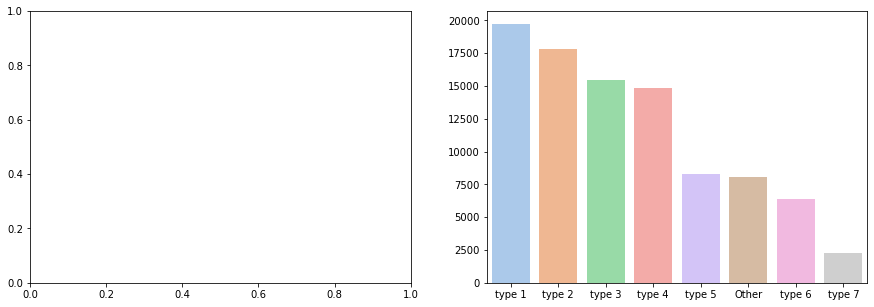

In [90]:
import matplotlib.pyplot as plt
import seaborn as sns
types_counts = result.Topic.value_counts()
fig, ax = plt.subplots(1, 2, figsize=(15,5))
types = sns.barplot(x = types_counts.index, y = types_counts.values, palette="pastel", ax=ax[1])


In [91]:
result['len'] = result.Text.apply(lambda row: len(row.split()))
result.head()

,Text,Topic,Lemma-text,len
0,"this child almost died tetanus, spent months h...",type 4,"[child, tetanus, month, hospital, cost, parent...",21
1,just remember mr. leblanc the pressure that th...,type 3,"[leblanc, pressure, business, world, border, a...",48
2,does it hurt your head actually use your brain...,type 2,"[head, brain, place, rate, case_count, dictato...",37
3,world-wide mass vaccination leading world-wide...,type 3,"[world, passport, goal]",11
4,oh i see. so what your saying is that alberta ...,type 3,"[business, proof, government, province]",26


In [92]:
result['Lemma_text'] = result['Lemma-text'].apply(lambda row: ' '.join(row))

In [93]:
result = result.drop('Lemma-text', axis=1)

In [94]:
from wordcloud import WordCloud 

In [95]:
def create_WordCloud(data, title=None):
    wordcloud = WordCloud(width = 500, height = 500,
                          background_color ='white',
                          min_font_size = 15, collocations=False
                         ).generate(" ".join(data.values))
                      
    plt.figure(figsize = (5, 5), facecolor = None) 
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(title,fontsize=20)
    plt.show() 

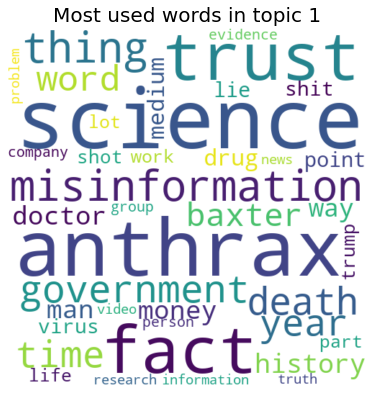

In [96]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 1'], title="Most used words in topic 1")

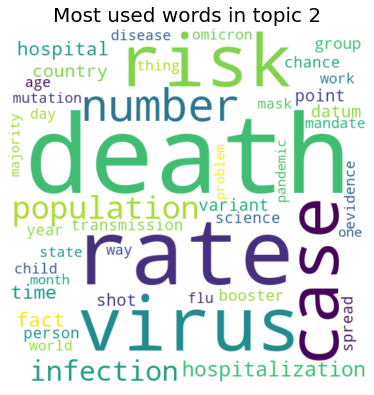

In [97]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 2'], title="Most used words in topic 2")

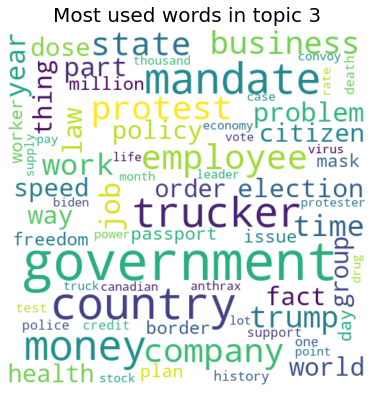

In [98]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 3'], title="Most used words in topic 3")

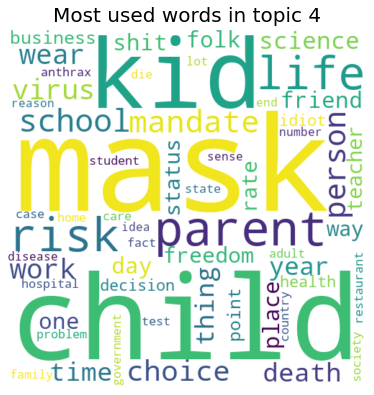

In [99]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 4'], title="Most used words in topic 4")

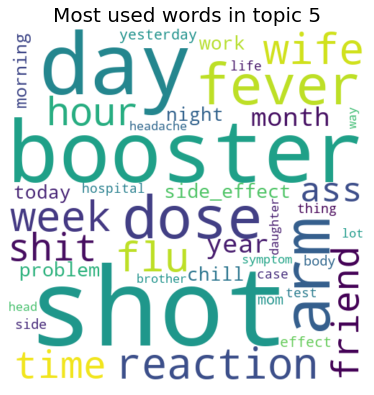

In [100]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 5'], title="Most used words in topic 5")

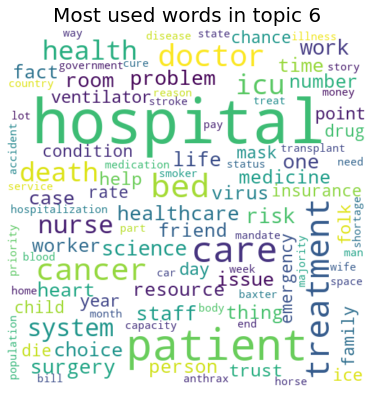

In [101]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 6'], title="Most used words in topic 6")

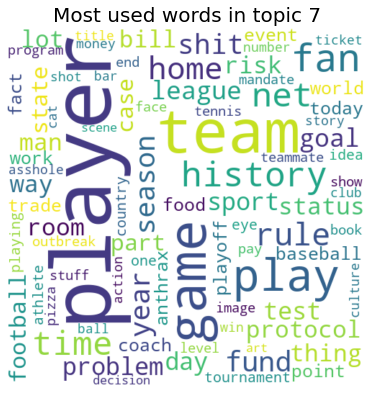

In [102]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 7'], title="Most used words in topic 7")

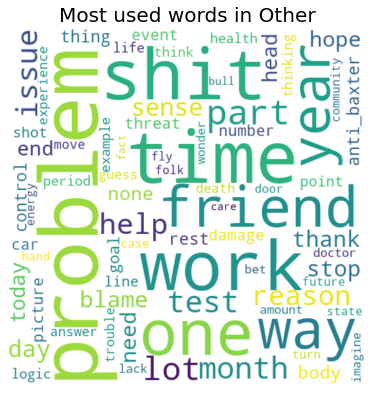

In [103]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'Other'], title="Most used words in Other")

### Cluster size: 8

In [104]:
mgp = MovieGroupProcess(K=8, alpha=0.1, beta=0.2, n_iters=30)

vocab = set(x for review in negative_tokenised_lemmatized for x in review)
n_terms = len(vocab)
model = mgp.fit(negative_tokenised_lemmatized, n_terms)

In stage 0: transferred 78429 clusters with 8 clusters populated
In stage 1: transferred 69208 clusters with 8 clusters populated
In stage 2: transferred 62476 clusters with 8 clusters populated
In stage 3: transferred 55180 clusters with 8 clusters populated
In stage 4: transferred 49100 clusters with 8 clusters populated
In stage 5: transferred 45429 clusters with 8 clusters populated
In stage 6: transferred 43265 clusters with 8 clusters populated
In stage 7: transferred 41876 clusters with 8 clusters populated
In stage 8: transferred 40795 clusters with 8 clusters populated
In stage 9: transferred 39968 clusters with 8 clusters populated
In stage 10: transferred 39515 clusters with 8 clusters populated
In stage 11: transferred 39272 clusters with 8 clusters populated
In stage 12: transferred 38758 clusters with 8 clusters populated
In stage 13: transferred 38176 clusters with 8 clusters populated
In stage 14: transferred 37969 clusters with 8 clusters populated
In stage 15: transfe

In [105]:
doc_count = np.array(mgp.cluster_doc_count)
print('Number of documents per topic :', doc_count)

# topics sorted by the number of document they are allocated to
top_index = doc_count.argsort()[-10:][::-1]
print('\nMost important clusters (by number of docs inside):', top_index)
# show the top 5 words in term frequency for each cluster 
top_words(mgp.cluster_word_distribution, top_index, 10)

Number of documents per topic : [ 8425  8701  9708  7092 18962  4325 15284 20326]

Most important clusters (by number of docs inside): [7 4 6 2 1 0 3 5]

Cluster 7 : [('science', 1429), ('anthrax', 1278), ('death', 936), ('fact', 927), ('misinformation', 812), ('thing', 767), ('trust', 758), ('time', 655), ('government', 614), ('year', 604)]

Cluster 4 : [('death', 4291), ('rate', 3074), ('virus', 1942), ('risk', 1783), ('case', 1626), ('number', 1537), ('population', 1381), ('hospitalization', 1123), ('infection', 1108), ('time', 993)]

Cluster 6 : [('mandate', 1295), ('government', 1207), ('trucker', 984), ('country', 831), ('mask', 753), ('protest', 658), ('employee', 617), ('business', 605), ('work', 577), ('time', 501)]

Cluster 2 : [('hospital', 2464), ('patient', 974), ('care', 697), ('bed', 536), ('treatment', 532), ('doctor', 508), ('death', 497), ('cancer', 479), ('health', 476), ('life', 436)]

Cluster 1 : [('shot', 1747), ('day', 1123), ('booster', 1070), ('arm', 619), ('do

In [106]:
# I don`t rename the clusters

topic_dict = {}
topic_names = ['type 1',
               'type 2',
               'type 3',
               'type 4',
               'type 5',
               'type 6',
               'type 7',
               'type 8'
              ]
for i, topic_num in enumerate(top_index):
    topic_dict[topic_num]=topic_names[i] 

In [107]:
def create_topics_dataframe(data_text=negative_df.new_text_after_translation,  mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized):
    result = pd.DataFrame(columns=['Text', 'Topic', 'Lemma-text'])
    for i, text in enumerate(data_text):
        result.at[i, 'Text'] = text
        result.at[i, 'Lemma-text'] = lemma_text[i]
        prob = mgp.choose_best_label(negative_tokenised_lemmatized[i])
        if prob[1] >= threshold:
            result.at[i, 'Topic'] = topic_dict[prob[0]]
        else:
            result.at[i, 'Topic'] = 'Other'
    return result

In [108]:
result = create_topics_dataframe(data_text=negative_df.new_text_after_translation, mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized)
result.head(5)

,Text,Topic,Lemma-text
0,"this child almost died tetanus, spent months h...",type 7,"[child, tetanus, month, hospital, cost, parent..."
1,just remember mr. leblanc the pressure that th...,type 3,"[leblanc, pressure, business, world, border, a..."
2,does it hurt your head actually use your brain...,type 2,"[head, brain, place, rate, case_count, dictato..."
3,world-wide mass vaccination leading world-wide...,type 3,"[world, passport, goal]"
4,oh i see. so what your saying is that alberta ...,type 3,"[business, proof, government, province]"


In [109]:
import plotly.express as px

fig = px.pie(result, names='Topic',  title='Topics', color_discrete_sequence=px.colors.sequential.Burg)
fig.show()

In [110]:
result['Topic']

0        type 7
1        type 3
2        type 2
3        type 3
4        type 3
          ...  
92818     Other
92819    type 5
92820    type 6
92821    type 2
92822    type 1
Name: Topic, Length: 92823, dtype: object

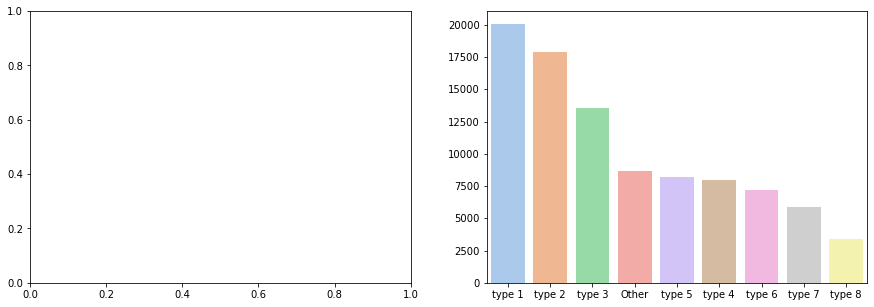

In [111]:
import matplotlib.pyplot as plt
import seaborn as sns
types_counts = result.Topic.value_counts()
fig, ax = plt.subplots(1, 2, figsize=(15,5))
types = sns.barplot(x = types_counts.index, y = types_counts.values, palette="pastel", ax=ax[1])


In [112]:
result['len'] = result.Text.apply(lambda row: len(row.split()))
result.head()

,Text,Topic,Lemma-text,len
0,"this child almost died tetanus, spent months h...",type 7,"[child, tetanus, month, hospital, cost, parent...",21
1,just remember mr. leblanc the pressure that th...,type 3,"[leblanc, pressure, business, world, border, a...",48
2,does it hurt your head actually use your brain...,type 2,"[head, brain, place, rate, case_count, dictato...",37
3,world-wide mass vaccination leading world-wide...,type 3,"[world, passport, goal]",11
4,oh i see. so what your saying is that alberta ...,type 3,"[business, proof, government, province]",26


In [113]:
result['Lemma_text'] = result['Lemma-text'].apply(lambda row: ' '.join(row))

In [114]:
result = result.drop('Lemma-text', axis=1)

In [115]:
from wordcloud import WordCloud 

In [116]:
def create_WordCloud(data, title=None):
    wordcloud = WordCloud(width = 500, height = 500,
                          background_color ='white',
                          min_font_size = 15, collocations=False
                         ).generate(" ".join(data.values))
                      
    plt.figure(figsize = (5, 5), facecolor = None) 
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(title,fontsize=20)
    plt.show() 

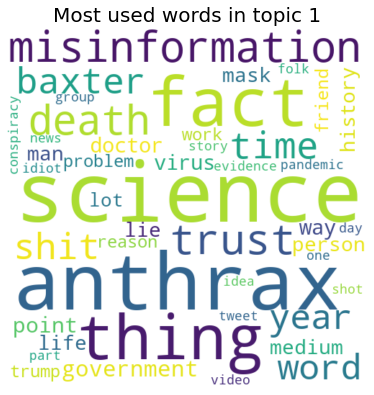

In [117]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 1'], title="Most used words in topic 1")

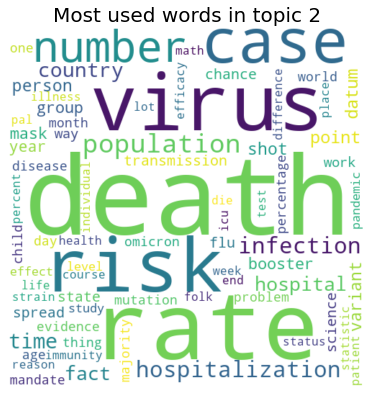

In [118]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 2'], title="Most used words in topic 2")

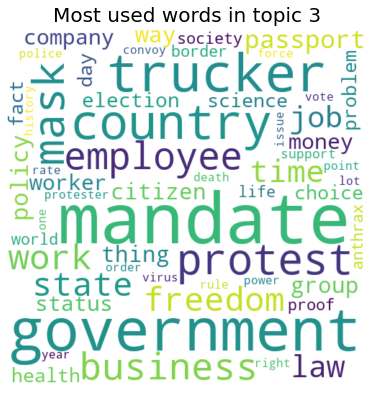

In [119]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 3'], title="Most used words in topic 3")

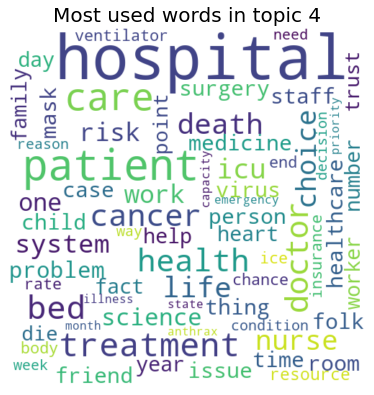

In [120]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 4'], title="Most used words in topic 4")

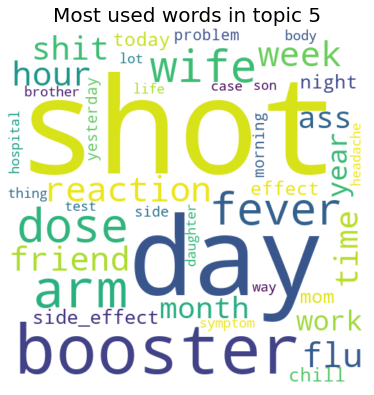

In [121]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 5'], title="Most used words in topic 5")

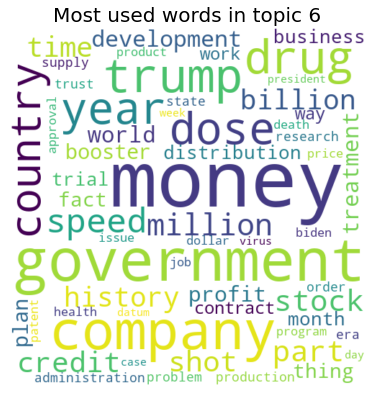

In [122]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 6'], title="Most used words in topic 6")

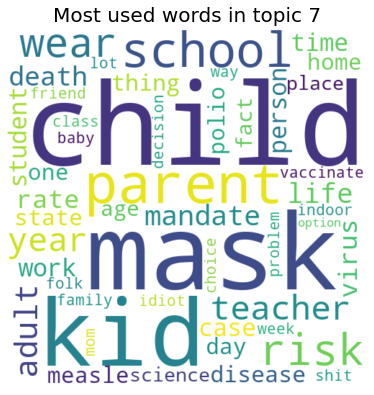

In [123]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 7'], title="Most used words in topic 7")

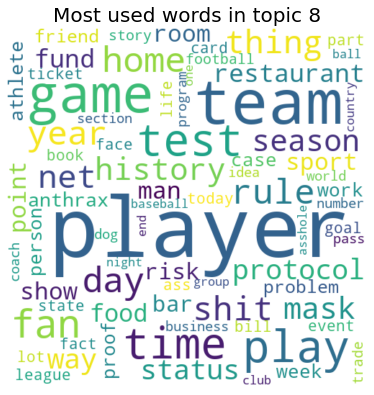

In [124]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 8'], title="Most used words in topic 8")

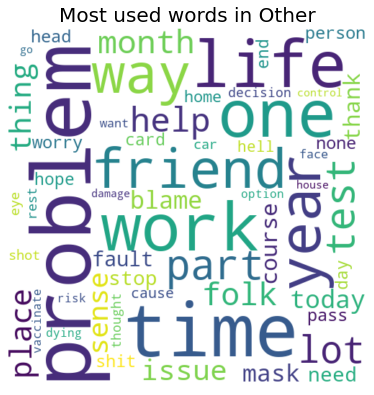

In [125]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'Other'], title="Most used words in Other")

### Cluster size: 9

In [126]:
mgp = MovieGroupProcess(K=9, alpha=0.1, beta=0.2, n_iters=30)

vocab = set(x for review in negative_tokenised_lemmatized for x in review)
n_terms = len(vocab)
model = mgp.fit(negative_tokenised_lemmatized, n_terms)

In stage 0: transferred 79645 clusters with 9 clusters populated
In stage 1: transferred 70145 clusters with 9 clusters populated
In stage 2: transferred 62527 clusters with 9 clusters populated
In stage 3: transferred 54186 clusters with 9 clusters populated
In stage 4: transferred 48678 clusters with 9 clusters populated
In stage 5: transferred 45468 clusters with 9 clusters populated
In stage 6: transferred 43587 clusters with 9 clusters populated
In stage 7: transferred 41756 clusters with 9 clusters populated
In stage 8: transferred 40646 clusters with 9 clusters populated
In stage 9: transferred 40006 clusters with 9 clusters populated
In stage 10: transferred 39480 clusters with 9 clusters populated
In stage 11: transferred 39099 clusters with 9 clusters populated
In stage 12: transferred 38727 clusters with 9 clusters populated
In stage 13: transferred 38439 clusters with 9 clusters populated
In stage 14: transferred 38143 clusters with 9 clusters populated
In stage 15: transfe

In [127]:
doc_count = np.array(mgp.cluster_doc_count)
print('Number of documents per topic :', doc_count)

# topics sorted by the number of document they are allocated to
top_index = doc_count.argsort()[-10:][::-1]
print('\nMost important clusters (by number of docs inside):', top_index)
# show the top 5 words in term frequency for each cluster 
top_words(mgp.cluster_word_distribution, top_index, 10)

Number of documents per topic : [  301  9842 14763 13371  2282 23517  2143  8638 17966]

Most important clusters (by number of docs inside): [5 8 2 3 1 7 4 6 0]

Cluster 5 : [('death', 4611), ('rate', 3220), ('hospital', 2759), ('risk', 2175), ('case', 1889), ('virus', 1766), ('number', 1672), ('population', 1397), ('hospitalization', 1216), ('infection', 1154)]

Cluster 8 : [('child', 1476), ('mandate', 1449), ('mask', 1212), ('government', 1112), ('trucker', 963), ('kid', 819), ('parent', 753), ('country', 700), ('employee', 691), ('work', 686)]

Cluster 2 : [('anthrax', 1067), ('science', 983), ('fact', 722), ('misinformation', 678), ('death', 543), ('thing', 525), ('trust', 524), ('government', 490), ('time', 456), ('doctor', 452)]

Cluster 3 : [('mask', 1567), ('virus', 927), ('death', 706), ('science', 631), ('life', 603), ('shit', 568), ('time', 514), ('shot', 509), ('thing', 506), ('wear', 445)]

Cluster 1 : [('shot', 1765), ('day', 1153), ('booster', 1078), ('arm', 615), ('wif

In [128]:
# I don`t rename the clusters

topic_dict = {}
topic_names = ['type 1',
               'type 2',
               'type 3',
               'type 4',
               'type 5',
               'type 6',
               'type 7',
               'type 8',
               'type 9'
              ]
for i, topic_num in enumerate(top_index):
    topic_dict[topic_num]=topic_names[i] 

In [129]:
def create_topics_dataframe(data_text=negative_df.new_text_after_translation,  mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized):
    result = pd.DataFrame(columns=['Text', 'Topic', 'Lemma-text'])
    for i, text in enumerate(data_text):
        result.at[i, 'Text'] = text
        result.at[i, 'Lemma-text'] = lemma_text[i]
        prob = mgp.choose_best_label(negative_tokenised_lemmatized[i])
        if prob[1] >= threshold:
            result.at[i, 'Topic'] = topic_dict[prob[0]]
        else:
            result.at[i, 'Topic'] = 'Other'
    return result

In [130]:
result = create_topics_dataframe(data_text=negative_df.new_text_after_translation, mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized)
result.head(5)

,Text,Topic,Lemma-text
0,"this child almost died tetanus, spent months h...",type 2,"[child, tetanus, month, hospital, cost, parent..."
1,just remember mr. leblanc the pressure that th...,type 2,"[leblanc, pressure, business, world, border, a..."
2,does it hurt your head actually use your brain...,type 4,"[head, brain, place, rate, case_count, dictato..."
3,world-wide mass vaccination leading world-wide...,type 2,"[world, passport, goal]"
4,oh i see. so what your saying is that alberta ...,type 2,"[business, proof, government, province]"


In [131]:
import plotly.express as px

fig = px.pie(result, names='Topic',  title='Topics', color_discrete_sequence=px.colors.sequential.Burg)
fig.show()

In [132]:
result['Topic']

0        type 2
1        type 2
2        type 4
3        type 2
4        type 2
          ...  
92818    type 5
92819    type 5
92820    type 2
92821    type 1
92822    type 3
Name: Topic, Length: 92823, dtype: object

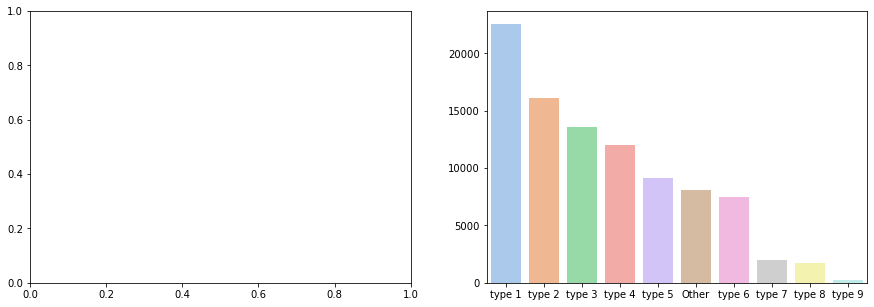

In [133]:
import matplotlib.pyplot as plt
import seaborn as sns
types_counts = result.Topic.value_counts()
fig, ax = plt.subplots(1, 2, figsize=(15,5))
types = sns.barplot(x = types_counts.index, y = types_counts.values, palette="pastel", ax=ax[1])


In [134]:
result['len'] = result.Text.apply(lambda row: len(row.split()))
result.head()

,Text,Topic,Lemma-text,len
0,"this child almost died tetanus, spent months h...",type 2,"[child, tetanus, month, hospital, cost, parent...",21
1,just remember mr. leblanc the pressure that th...,type 2,"[leblanc, pressure, business, world, border, a...",48
2,does it hurt your head actually use your brain...,type 4,"[head, brain, place, rate, case_count, dictato...",37
3,world-wide mass vaccination leading world-wide...,type 2,"[world, passport, goal]",11
4,oh i see. so what your saying is that alberta ...,type 2,"[business, proof, government, province]",26


In [135]:
result['Lemma_text'] = result['Lemma-text'].apply(lambda row: ' '.join(row))

In [136]:
result = result.drop('Lemma-text', axis=1)

In [137]:
from wordcloud import WordCloud 

In [138]:
def create_WordCloud(data, title=None):
    wordcloud = WordCloud(width = 500, height = 500,
                          background_color ='white',
                          min_font_size = 15, collocations=False
                         ).generate(" ".join(data.values))
                      
    plt.figure(figsize = (5, 5), facecolor = None) 
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(title,fontsize=20)
    plt.show() 

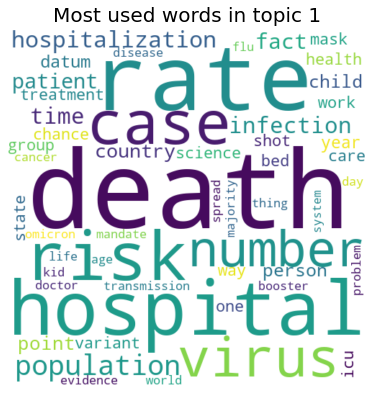

In [139]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 1'], title="Most used words in topic 1")

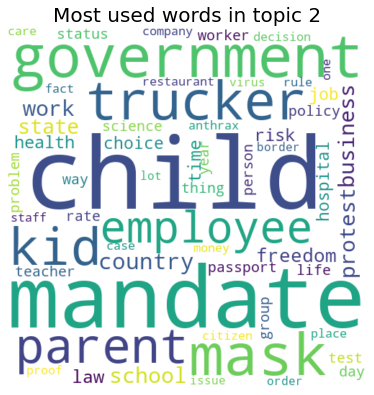

In [140]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 2'], title="Most used words in topic 2")

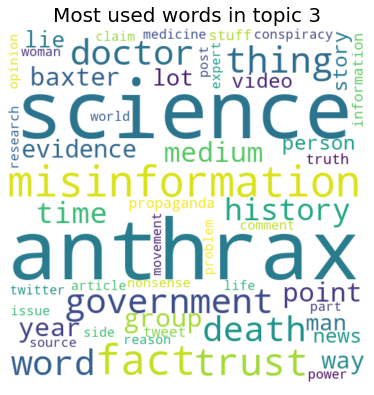

In [141]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 3'], title="Most used words in topic 3")

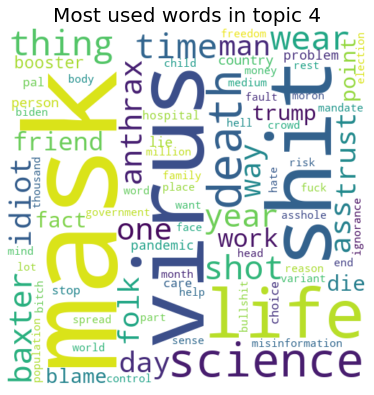

In [142]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 4'], title="Most used words in topic 4")

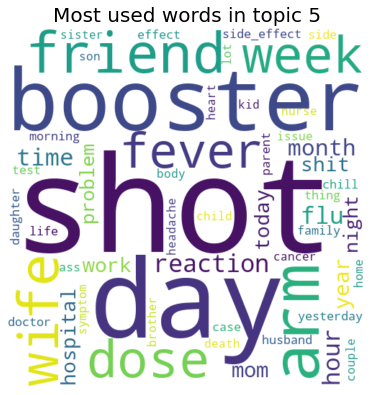

In [143]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 5'], title="Most used words in topic 5")

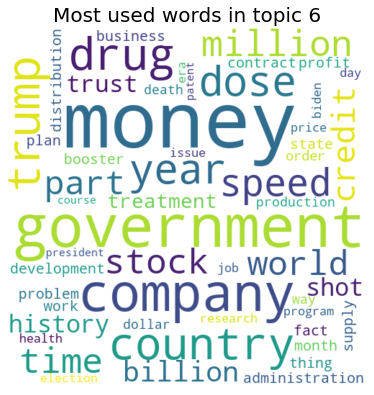

In [144]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 6'], title="Most used words in topic 6")

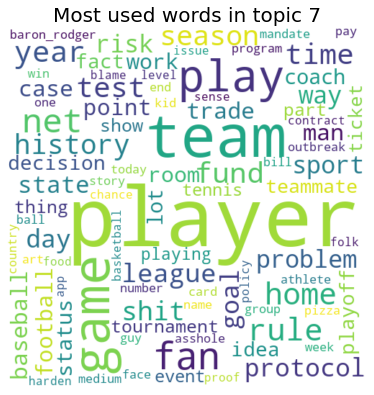

In [145]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 7'], title="Most used words in topic 7")

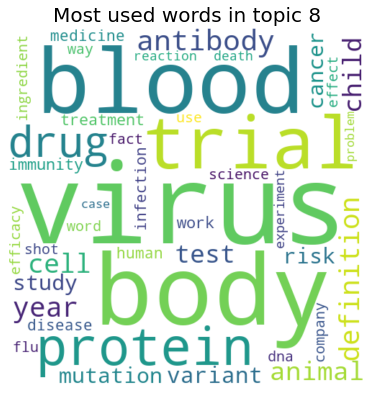

In [146]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 8'], title="Most used words in topic 8")

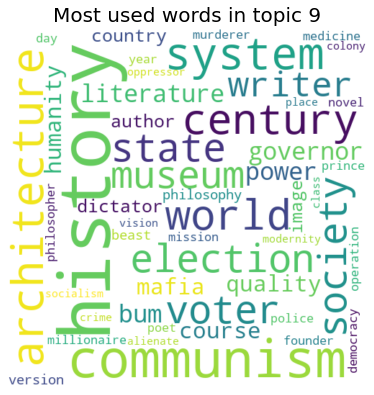

In [147]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 9'], title="Most used words in topic 9")

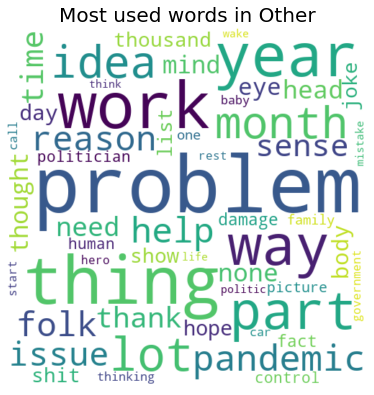

In [148]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'Other'], title="Most used words in Other")

### Cluster size: 10

In [149]:
mgp = MovieGroupProcess(K=10, alpha=0.1, beta=0.2, n_iters=30)

vocab = set(x for review in negative_tokenised_lemmatized for x in review)
n_terms = len(vocab)
model = mgp.fit(negative_tokenised_lemmatized, n_terms)

In stage 0: transferred 80685 clusters with 10 clusters populated
In stage 1: transferred 71189 clusters with 10 clusters populated
In stage 2: transferred 63731 clusters with 10 clusters populated
In stage 3: transferred 56162 clusters with 10 clusters populated
In stage 4: transferred 50812 clusters with 10 clusters populated
In stage 5: transferred 46835 clusters with 10 clusters populated
In stage 6: transferred 44453 clusters with 10 clusters populated
In stage 7: transferred 43188 clusters with 10 clusters populated
In stage 8: transferred 42175 clusters with 10 clusters populated
In stage 9: transferred 41149 clusters with 10 clusters populated
In stage 10: transferred 40539 clusters with 10 clusters populated
In stage 11: transferred 40057 clusters with 10 clusters populated
In stage 12: transferred 39716 clusters with 10 clusters populated
In stage 13: transferred 39516 clusters with 10 clusters populated
In stage 14: transferred 39017 clusters with 10 clusters populated
In st

In [150]:
doc_count = np.array(mgp.cluster_doc_count)
print('Number of documents per topic :', doc_count)

# topics sorted by the number of document they are allocated to
top_index = doc_count.argsort()[-10:][::-1]
print('\nMost important clusters (by number of docs inside):', top_index)
# show the top 5 words in term frequency for each cluster 
top_words(mgp.cluster_word_distribution, top_index, 10)

Number of documents per topic : [ 9217  8811  8248  8757 20594  5994 19122  1943  1832  8305]

Most important clusters (by number of docs inside): [4 6 0 1 3 9 2 5 7 8]

Cluster 4 : [('government', 1257), ('country', 1101), ('science', 1014), ('death', 960), ('mandate', 936), ('mask', 936), ('time', 767), ('anthrax', 692), ('thing', 661), ('virus', 654)]

Cluster 6 : [('death', 4299), ('rate', 3028), ('virus', 1899), ('risk', 1830), ('case', 1681), ('number', 1472), ('population', 1309), ('infection', 1127), ('hospitalization', 1123), ('fact', 996)]

Cluster 0 : [('hospital', 2414), ('patient', 1012), ('care', 650), ('doctor', 563), ('bed', 548), ('treatment', 523), ('death', 520), ('cancer', 489), ('health', 414), ('icu', 390)]

Cluster 1 : [('anthrax', 764), ('science', 576), ('misinformation', 435), ('fact', 397), ('word', 376), ('thing', 332), ('time', 277), ('trust', 265), ('doctor', 257), ('man', 226)]

Cluster 3 : [('money', 874), ('government', 798), ('company', 571), ('drug', 

In [151]:
# I don`t rename the clusters

topic_dict = {}
topic_names = ['type 1',
               'type 2',
               'type 3',
               'type 4',
               'type 5',
               'type 6',
               'type 7',
               'type 8',
               'type 9',
               'type 10'
              ]
for i, topic_num in enumerate(top_index):
    topic_dict[topic_num]=topic_names[i] 

In [152]:
def create_topics_dataframe(data_text=negative_df.new_text_after_translation,  mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized):
    result = pd.DataFrame(columns=['Text', 'Topic', 'Lemma-text'])
    for i, text in enumerate(data_text):
        result.at[i, 'Text'] = text
        result.at[i, 'Lemma-text'] = lemma_text[i]
        prob = mgp.choose_best_label(negative_tokenised_lemmatized[i])
        if prob[1] >= threshold:
            result.at[i, 'Topic'] = topic_dict[prob[0]]
        else:
            result.at[i, 'Topic'] = 'Other'
    return result

In [153]:
result = create_topics_dataframe(data_text=negative_df.new_text_after_translation, mgp=mgp, threshold=0.3, topic_dict=topic_dict, lemma_text=negative_tokenised_lemmatized)
result.head(5)

,Text,Topic,Lemma-text
0,"this child almost died tetanus, spent months h...",type 7,"[child, tetanus, month, hospital, cost, parent..."
1,just remember mr. leblanc the pressure that th...,type 8,"[leblanc, pressure, business, world, border, a..."
2,does it hurt your head actually use your brain...,type 2,"[head, brain, place, rate, case_count, dictato..."
3,world-wide mass vaccination leading world-wide...,type 1,"[world, passport, goal]"
4,oh i see. so what your saying is that alberta ...,type 8,"[business, proof, government, province]"


In [154]:
import plotly.express as px

fig = px.pie(result, names='Topic',  title='Topics', color_discrete_sequence=px.colors.sequential.Burg)
fig.show()

In [155]:
result['Topic']

0        type 7
1        type 8
2        type 2
3        type 1
4        type 8
          ...  
92818     Other
92819    type 7
92820    type 1
92821    type 2
92822    type 1
Name: Topic, Length: 92823, dtype: object

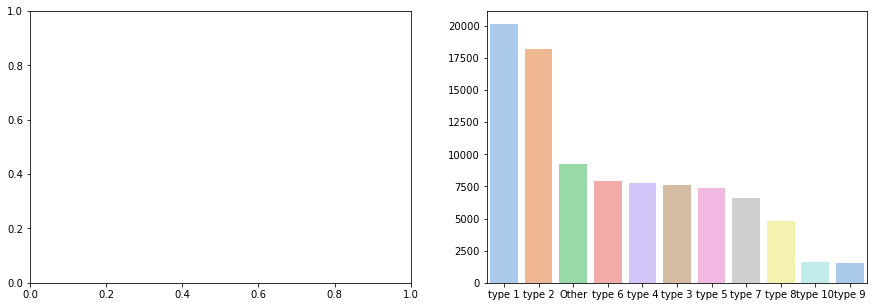

In [156]:
import matplotlib.pyplot as plt
import seaborn as sns
types_counts = result.Topic.value_counts()
fig, ax = plt.subplots(1, 2, figsize=(15,5))
types = sns.barplot(x = types_counts.index, y = types_counts.values, palette="pastel", ax=ax[1])


In [157]:
result['len'] = result.Text.apply(lambda row: len(row.split()))
result.head()

,Text,Topic,Lemma-text,len
0,"this child almost died tetanus, spent months h...",type 7,"[child, tetanus, month, hospital, cost, parent...",21
1,just remember mr. leblanc the pressure that th...,type 8,"[leblanc, pressure, business, world, border, a...",48
2,does it hurt your head actually use your brain...,type 2,"[head, brain, place, rate, case_count, dictato...",37
3,world-wide mass vaccination leading world-wide...,type 1,"[world, passport, goal]",11
4,oh i see. so what your saying is that alberta ...,type 8,"[business, proof, government, province]",26


In [158]:
result['Lemma_text'] = result['Lemma-text'].apply(lambda row: ' '.join(row))

In [159]:
result = result.drop('Lemma-text', axis=1)

In [160]:
from wordcloud import WordCloud 

In [161]:
def create_WordCloud(data, title=None):
    wordcloud = WordCloud(width = 500, height = 500,
                          background_color ='white',
                          min_font_size = 15, collocations=False
                         ).generate(" ".join(data.values))
                      
    plt.figure(figsize = (5, 5), facecolor = None) 
    plt.imshow(wordcloud, interpolation='bilinear') 
    plt.axis("off") 
    plt.tight_layout(pad = 0) 
    plt.title(title,fontsize=20)
    plt.show() 

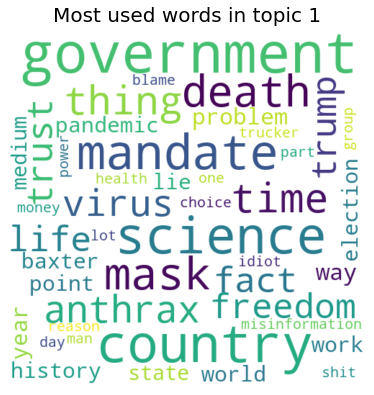

In [162]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 1'], title="Most used words in topic 1")

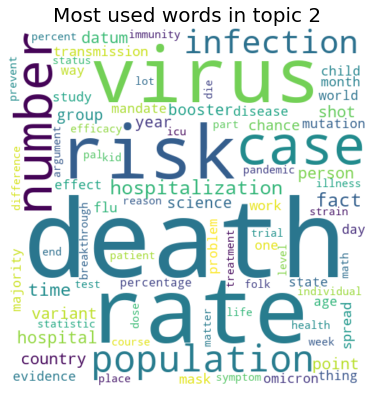

In [163]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 2'], title="Most used words in topic 2")

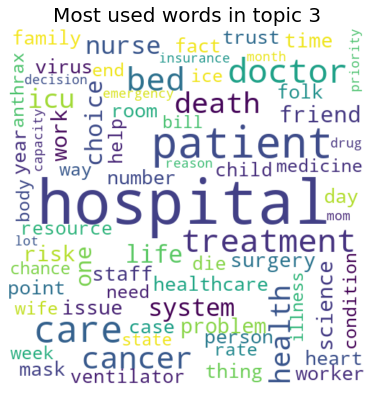

In [164]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 3'], title="Most used words in topic 3")

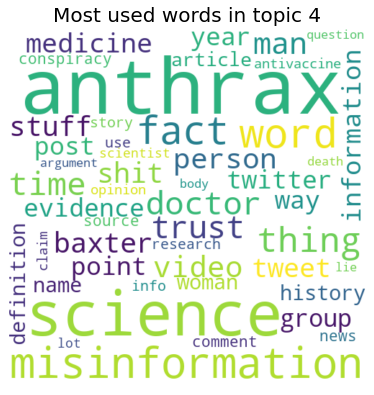

In [165]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 4'], title="Most used words in topic 4")

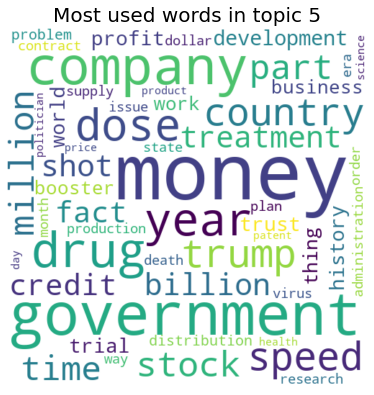

In [166]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 5'], title="Most used words in topic 5")

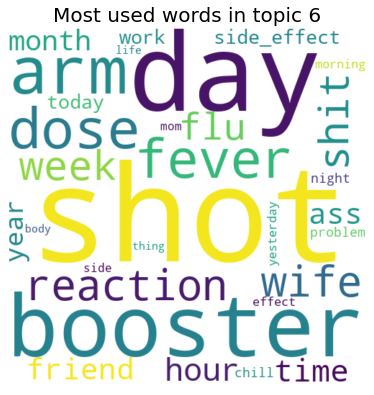

In [167]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 6'], title="Most used words in topic 6")

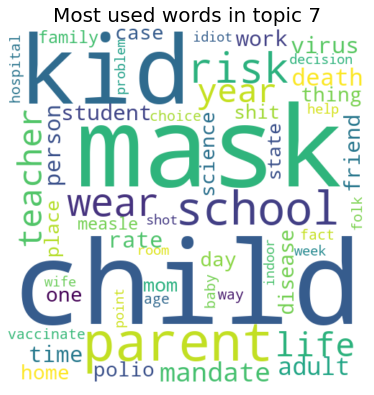

In [168]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 7'], title="Most used words in topic 7")

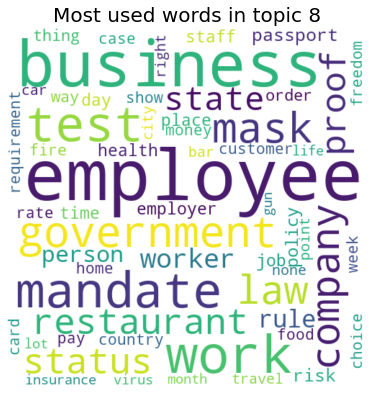

In [169]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 8'], title="Most used words in topic 8")

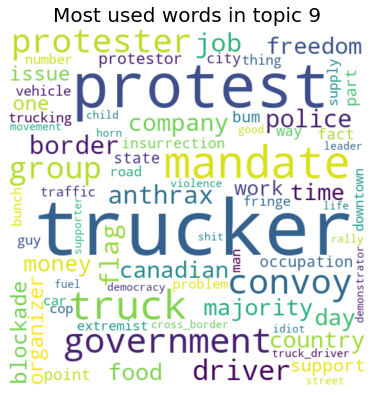

In [170]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 9'], title="Most used words in topic 9")

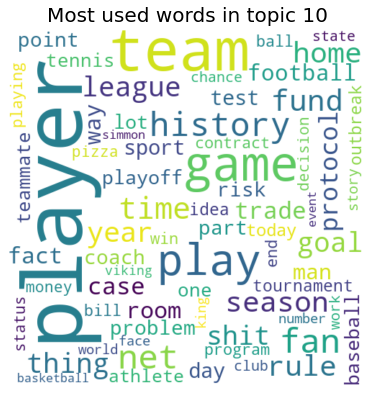

In [171]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'type 10'], title="Most used words in topic 10")

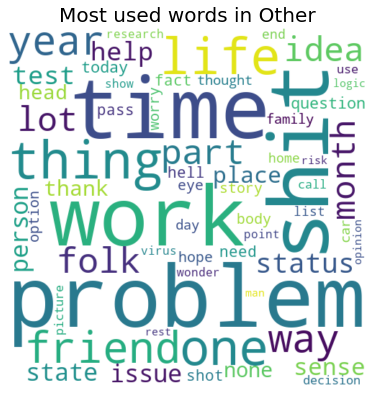

In [172]:
create_WordCloud(result['Lemma_text'].loc[result.Topic == 'Other'], title="Most used words in Other")